In [10]:
import os
import numpy as np
import pandas as pd
from datetime import datetime, timedelta,date

# 
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_theme(style="whitegrid")
sns.set_palette('icefire_r', 2)
import plotly.express as px
import plotly.io as pio
from plotly.io import show


import warnings

%matplotlib inline
#Przetwarzanie

# Baza danych gównych do nauki modelu
train = pd.read_csv("covid.csv") 

In [11]:
train.head()

,iso_code,continent,location,date,total_cases,new_cases,new_cases_smoothed,total_deaths,new_deaths,new_deaths_smoothed,...,female_smokers,male_smokers,handwashing_facilities,hospital_beds_per_thousand,life_expectancy,human_development_index,excess_mortality_cumulative_absolute,excess_mortality_cumulative,excess_mortality,excess_mortality_cumulative_per_million
0,AFG,Asia,Afghanistan,2020-02-24,5.0,5.0,NaN,NaN,NaN,NaN,...,NaN,NaN,37.746,0.5,64.83,0.511,NaN,NaN,NaN,NaN
1,AFG,Asia,Afghanistan,2020-02-25,5.0,0.0,NaN,NaN,NaN,NaN,...,NaN,NaN,37.746,0.5,64.83,0.511,NaN,NaN,NaN,NaN
2,AFG,Asia,Afghanistan,2020-02-26,5.0,0.0,NaN,NaN,NaN,NaN,...,NaN,NaN,37.746,0.5,64.83,0.511,NaN,NaN,NaN,NaN
3,AFG,Asia,Afghanistan,2020-02-27,5.0,0.0,NaN,NaN,NaN,NaN,...,NaN,NaN,37.746,0.5,64.83,0.511,NaN,NaN,NaN,NaN
4,AFG,Asia,Afghanistan,2020-02-28,5.0,0.0,NaN,NaN,NaN,NaN,...,NaN,NaN,37.746,0.5,64.83,0.511,NaN,NaN,NaN,NaN


In [12]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 166326 entries, 0 to 166325
Data columns (total 67 columns):
 #   Column                                      Non-Null Count   Dtype  
---  ------                                      --------------   -----  
 0   iso_code                                    166326 non-null  object 
 1   continent                                   156370 non-null  object 
 2   location                                    166326 non-null  object 
 3   date                                        166326 non-null  object 
 4   total_cases                                 163293 non-null  float64
 5   new_cases                                   163133 non-null  float64
 6   new_cases_smoothed                          161150 non-null  float64
 7   total_deaths                                145451 non-null  float64
 8   new_deaths                                  145487 non-null  float64
 9   new_deaths_smoothed                         143390 non-null  float64
 

In [5]:
print(pd.isnull(train).sum())

Region                  0
Country                 0
State             1450990
City                    0
Month                   0
Day                     0
Year                    0
AvgTemperature          0
dtype: int64


In [7]:
cols= ['Region', 'Country', 'City' ]
for col in cols:
  df_grouped = train.groupby(col)[col].count()
  df_grouped = df_grouped / train[col].count() * 100
  print(f"Unique value counts and percentages for column {col}:")
  print(df_grouped)

Unique value counts and percentages for column Region:
Region
Africa                                8.640390
Asia                                 10.895643
Australia/South Pacific               1.912930
Europe                               13.143394
Middle East                           4.292325
North America                        53.561798
South/Central America & Carribean     7.553520
Name: Region, dtype: float64
Unique value counts and percentages for column Country:
Country
Albania       0.318822
Algeria       0.318822
Argentina     0.318822
Australia     1.594108
Austria       0.318822
                ...   
Uzbekistan    0.318822
Venezuela     0.318787
Vietnam       0.318822
Yugoslavia    0.318822
Zambia        0.239546
Name: Country, Length: 125, dtype: float64
Unique value counts and percentages for column City:
City
Abidjan         0.318822
Abilene         0.318822
Abu Dhabi       0.318822
Addis Ababa     0.319819
Akron Canton    0.318787
                  ...   
Yerevan     

In [9]:
from sklearn.preprocessing import OrdinalEncoder
enc = OrdinalEncoder()
Enc_col = ['Region', 'Country', 'City' ]
# Fit the encoder and create the mapping for each column separately
categories = {}
for col in Enc_col:
    for df in [train]:
        df[col + '_Enc'] = enc.fit_transform(df[col].values.reshape(-1, 1))
    categories[col] = enc.categories_[0]  # Store categories for the current column

# Print the mapping
for col in Enc_col:
    print(f"Kolumna: {col}")
    for i, category in enumerate(categories[col]):
        print(f"  Wartość zakodowana: {i} -> Wartość początkowa: {category}")

Kolumna: Region
  Wartość zakodowana: 0 -> Wartość początkowa: Africa
  Wartość zakodowana: 1 -> Wartość początkowa: Asia
  Wartość zakodowana: 2 -> Wartość początkowa: Australia/South Pacific
  Wartość zakodowana: 3 -> Wartość początkowa: Europe
  Wartość zakodowana: 4 -> Wartość początkowa: Middle East
  Wartość zakodowana: 5 -> Wartość początkowa: North America
  Wartość zakodowana: 6 -> Wartość początkowa: South/Central America & Carribean
Kolumna: Country
  Wartość zakodowana: 0 -> Wartość początkowa: Albania
  Wartość zakodowana: 1 -> Wartość początkowa: Algeria
  Wartość zakodowana: 2 -> Wartość początkowa: Argentina
  Wartość zakodowana: 3 -> Wartość początkowa: Australia
  Wartość zakodowana: 4 -> Wartość początkowa: Austria
  Wartość zakodowana: 5 -> Wartość początkowa: Bahamas
  Wartość zakodowana: 6 -> Wartość początkowa: Bahrain
  Wartość zakodowana: 7 -> Wartość początkowa: Bangladesh
  Wartość zakodowana: 8 -> Wartość początkowa: Barbados
  Wartość zakodowana: 9 -> Warto

In [35]:
categorical_features = ['id','country', 'store', 'product' ]
for df in [train, test]:
     df.drop(columns=categorical_features, inplace=True)

In [36]:
train.tail()

,date,num_sold,country_Enc,store_Enc,product_Enc
136945,2021-12-31,700,4.0,0.0,0.0
136946,2021-12-31,752,4.0,0.0,1.0
136947,2021-12-31,111,4.0,0.0,2.0
136948,2021-12-31,641,4.0,0.0,3.0
136949,2021-12-31,539,4.0,0.0,4.0


In [37]:
test.head()

,date,country_Enc,store_Enc,product_Enc
0,2022-01-01,0.0,1.0,0.0
1,2022-01-01,0.0,1.0,1.0
2,2022-01-01,0.0,1.0,2.0
3,2022-01-01,0.0,1.0,3.0
4,2022-01-01,0.0,1.0,4.0


In [38]:
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 136950 entries, 0 to 136949
Data columns (total 5 columns):
 #   Column       Non-Null Count   Dtype         
---  ------       --------------   -----         
 0   date         136950 non-null  datetime64[ns]
 1   num_sold     136950 non-null  int64         
 2   country_Enc  136950 non-null  float64       
 3   store_Enc    136950 non-null  float64       
 4   product_Enc  136950 non-null  float64       
dtypes: datetime64[ns](1), float64(3), int64(1)
memory usage: 5.2 MB


In [39]:
train[['country_Enc', 'store_Enc', 'product_Enc']] = train[['country_Enc', 'store_Enc', 'product_Enc']].astype(np.int8)
test[['country_Enc', 'store_Enc', 'product_Enc']] = test[['country_Enc', 'store_Enc', 'product_Enc']].astype(np.int8)
train['num_sold'] = train['num_sold'].astype(np.int16)

In [40]:
test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 27375 entries, 0 to 27374
Data columns (total 4 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   date         27375 non-null  datetime64[ns]
 1   country_Enc  27375 non-null  int8          
 2   store_Enc    27375 non-null  int8          
 3   product_Enc  27375 non-null  int8          
dtypes: datetime64[ns](1), int8(3)
memory usage: 294.2 KB


In [41]:
train['year'] = pd.to_datetime(train['date']).dt.year
train['month'] = pd.to_datetime(train['date']).dt.month
train['day'] = pd.to_datetime(train['date']).dt.day
test['year'] = pd.to_datetime(test['date']).dt.year
test['month'] = pd.to_datetime(test['date']).dt.month
test['day'] = pd.to_datetime(test['date']).dt.day


print(train['date'].isna().any()) 
train = train.set_index('date')
test = test.set_index('date')

False


In [42]:
train.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 136950 entries, 2017-01-01 to 2021-12-31
Data columns (total 7 columns):
 #   Column       Non-Null Count   Dtype
---  ------       --------------   -----
 0   num_sold     136950 non-null  int16
 1   country_Enc  136950 non-null  int8 
 2   store_Enc    136950 non-null  int8 
 3   product_Enc  136950 non-null  int8 
 4   year         136950 non-null  int32
 5   month        136950 non-null  int32
 6   day          136950 non-null  int32
dtypes: int16(1), int32(3), int8(3)
memory usage: 3.3 MB


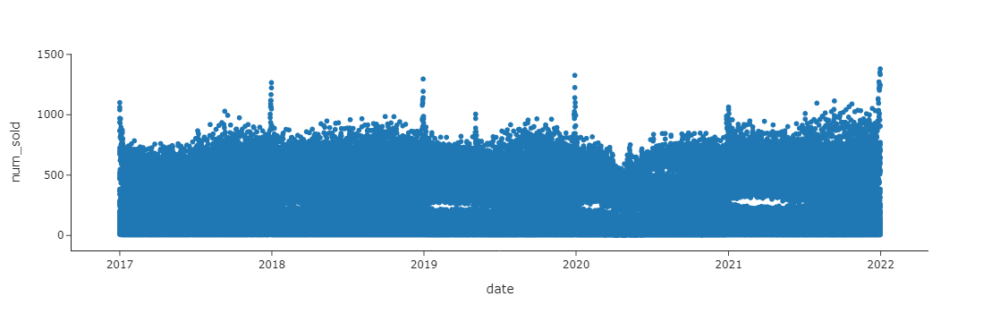

In [43]:
fig = px.scatter(train, x=train.index , y="num_sold", trendline="ols", template="simple_white")
fig.show()

In [44]:
import torch
import torch.nn as nn
import torch.optim as optim

from torch.utils.data import Dataset, DataLoader
from torch.optim import Adam  # Import Adam optimizer

from tqdm import tqdm
torch.set_num_threads(12)


In [47]:
features = ['year', 'month', 'day', "country_Enc", "store_Enc", "product_Enc"]
target   = 'num_sold'

# Przygotuj dane dla modelu
X_train = train[features]
y_train = train[target]

X_test = test[features]

# Konwertuj dane na tensory PyTorch
X_tensor_train = torch.from_numpy(X_train.to_numpy()).float()
y_tensor_train = torch.from_numpy(y_train.to_numpy()).float().reshape(-1, 1)

# Konwertuj dane na tensory PyTorch
X_tensor_test = torch.from_numpy(X_test.to_numpy()).float()

class MyDataset(torch.utils.data.Dataset):
  def __init__(self, X_tensor, y_tensor):
    if y_tensor is not None:
      # Handle missing labels (e.g., assign a specific value)
      self.y_tensor = [label if label is not None else -1 for label in y_tensor]
    self.X_tensor = X_tensor
    self.y_tensor = y_tensor

  def __getitem__(self, idx):
    X = self.X_tensor[idx]
    y = self.y_tensor[idx]
    return X, y

  def __len__(self):
    return len(self.X_tensor)

train_dataset = MyDataset(X_tensor_train, y_tensor_train)
test_dataset = MyDataset(X_tensor_test, None) 

train_size = int(0.6 * len(train_dataset))
val_size = len(train_dataset) - train_size
train_dataset, val_dataset = torch.utils.data.random_split(train_dataset, [train_size, val_size])

# Create a DataLoader for batch training
batch_size = 1920 # Adjust batch size as needed
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True)
test_loader  = DataLoader(test_dataset, batch_size=batch_size, shuffle=False)

Epoch 1/36 Loss: 489.42: 100%|██████████| 43/43 [14:49<00:00, 20.68s/it]


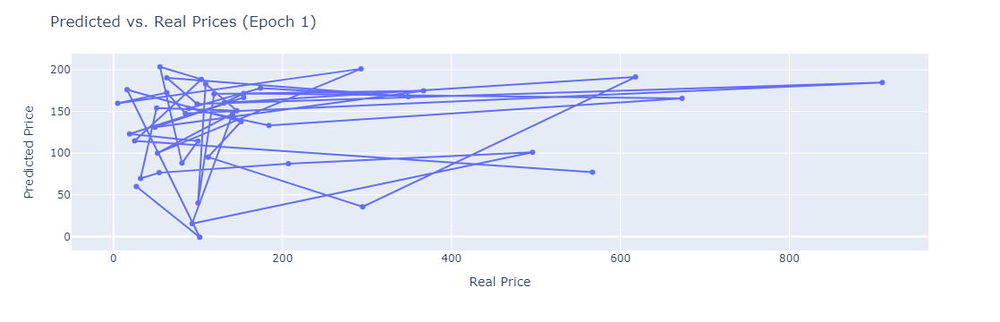

Epoch 2/36 Loss: 365.32: 100%|██████████| 43/43 [17:55<00:00, 25.00s/it]


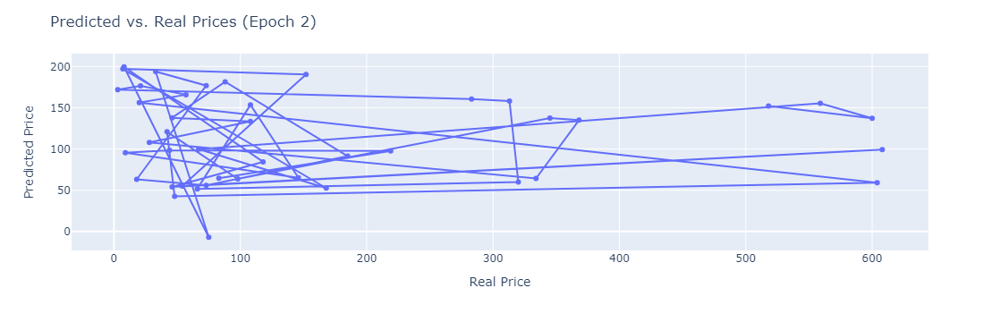

Epoch 3/36 Loss: 124.67: 100%|██████████| 43/43 [17:38<00:00, 24.61s/it]


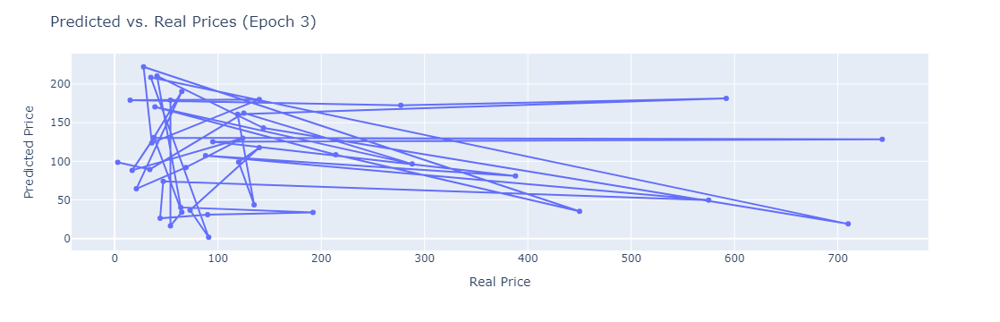

Epoch 4/36 Loss: 105.74: 100%|██████████| 43/43 [17:16<00:00, 24.09s/it]


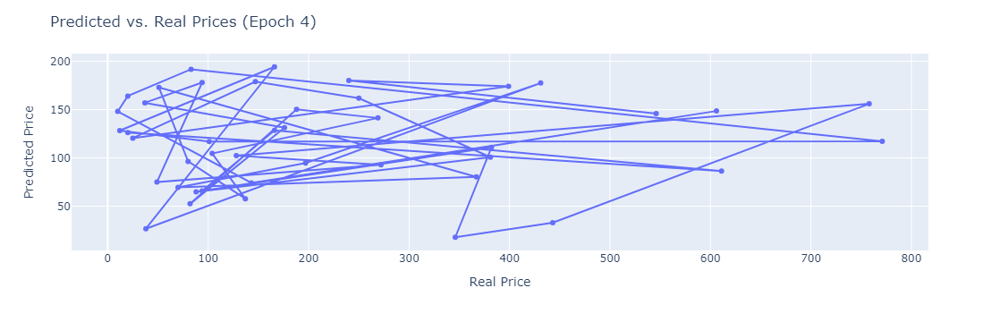

Epoch 5/36 Loss: 14.70: 100%|██████████| 43/43 [16:43<00:00, 23.34s/it] 


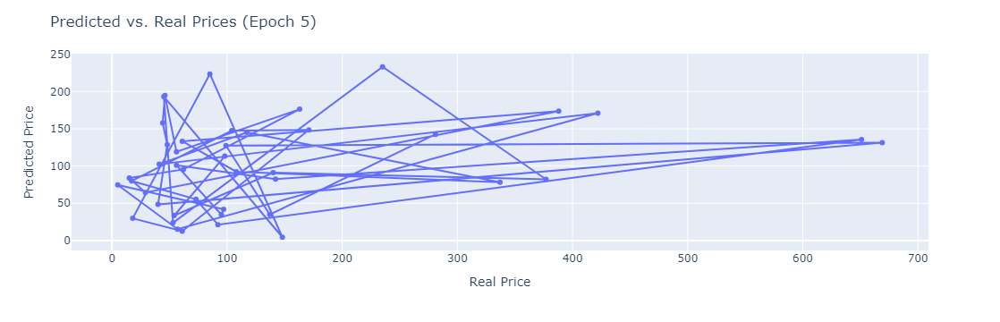

Epoch 6/36 Loss: 21.92: 100%|██████████| 43/43 [16:42<00:00, 23.32s/it] 


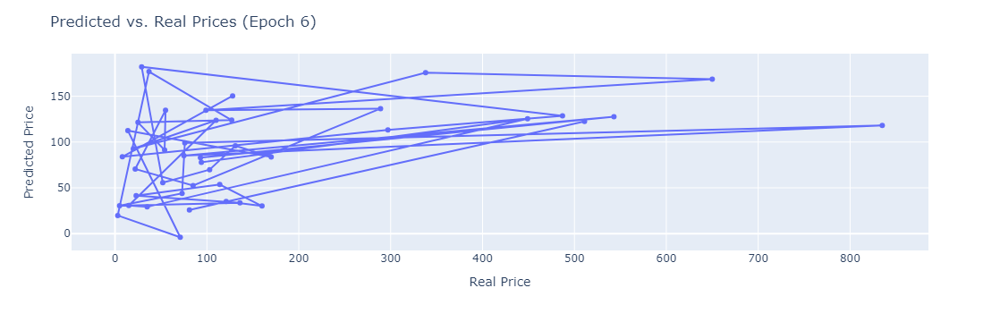

Epoch 7/36 Loss: 139.43: 100%|██████████| 43/43 [16:43<00:00, 23.33s/it]


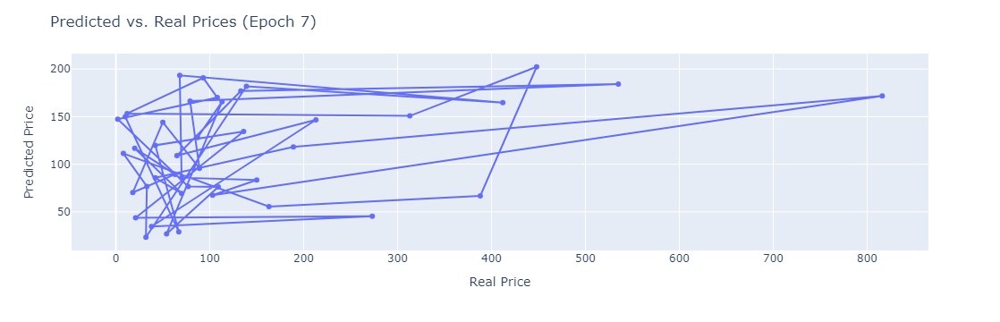

Epoch 8/36 Loss: 1.62: 100%|██████████| 43/43 [16:41<00:00, 23.30s/it]  


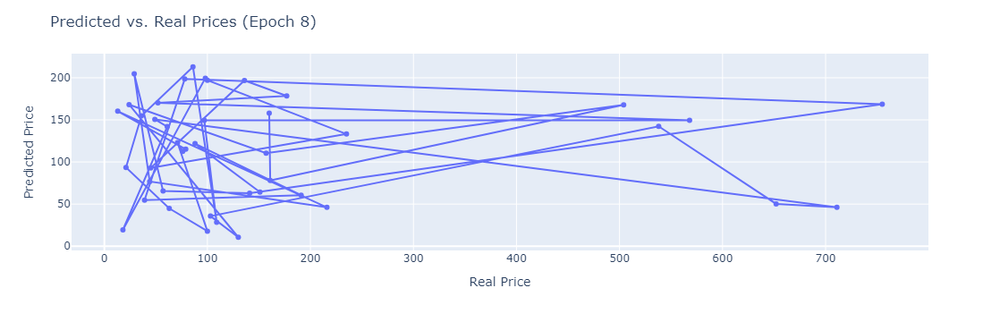

Epoch 9/36 Loss: 3.86: 100%|██████████| 43/43 [16:43<00:00, 23.34s/it]  


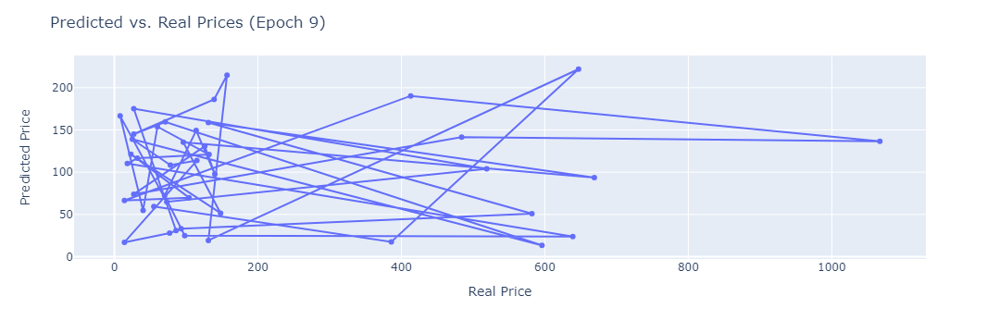

Epoch 10/36 Loss: 4.48: 100%|██████████| 43/43 [16:41<00:00, 23.30s/it]  


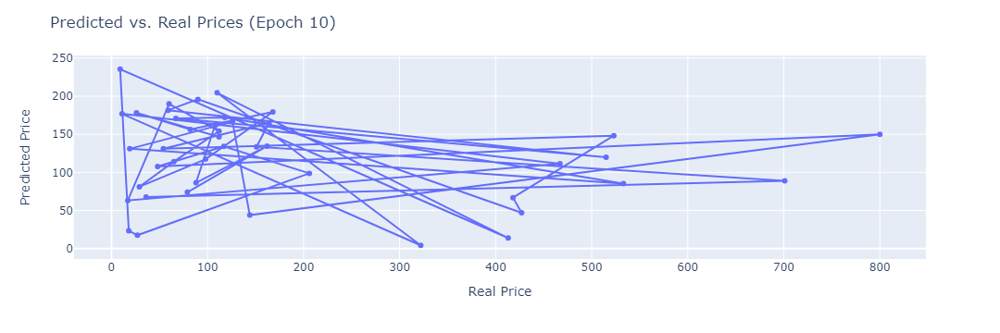

Epoch 11/36 Loss: 610.90:  60%|██████    | 26/43 [10:47<07:22, 26.05s/it]

In [ ]:
class LSTMModel(nn.Module):
  def __init__(self, input_dim, hidden_dim, output_dim):
    super(LSTMModel, self).__init__()
    self.lstm = nn.LSTM(input_dim, hidden_dim, num_layers, dropout=0.2)  # Add dropout for regularization
    self.fc = nn.Linear(hidden_dim, output_dim)
    self.silu = nn.SiLU()  # Add SiLU activation layer

  def forward(self, x):
    # Pass the input through LSTM layers
    x, (hidden, cell) = self.lstm(x)
    # Use the output from the last hidden layer
    x = hidden[-1]
    # Apply SiLU activation before linear layer
    x = self.silu(x)
    # Apply linear layer for prediction
    x = self.fc(x)
    return x
      
# Hyperparameters (adjust as needed)
input_dim = len(features)  # Number of features
hidden_dim = 192
num_layers = 8
output_dim = 1  # Assuming predicting single value (num_sold)

model = LSTMModel(input_dim, hidden_dim, output_dim).float()
criterion = nn.HuberLoss()
optimizer = torch.optim.NAdam(model.parameters(), lr=0.005)  # Set learning rate

# Create the Plotly figure outside the loop (start with empty data)
fig = px.scatter(x=None, y=None, trendline="ols")  # Empty data for initial plot
fig.update_layout(title="Predicted vs. Real Prices",  # Set initial title
                   xaxis_title="Real Price",
                   yaxis_title="Predicted Price",
                   showlegend=False)  # Hide legend if not needed

# Training loop
num_epochs = 36
best_loss = float('inf')
predicted_values = []
real_values = []


for epoch in range(num_epochs):
  model.train()  # Set model to training mode
  pbar = tqdm(train_loader)  # Wrap train_loader with tqdm
  for batch_x, batch_y in pbar:
    optimizer.zero_grad()
    for x, y in zip(batch_x, batch_y):
      x = x.unsqueeze(0)
      y_pred = model(x)
      loss = criterion(y_pred, y)
      loss.backward()
      optimizer.step()
    # Update progress bar with relevant metric (e.g., loss)
    pbar.set_description(f"Epoch {epoch+1}/{num_epochs} Loss: {loss.item():.2f}")

# Append predicted and real values for visualization (after each batch)\n",
    predicted_values.append(y_pred.item())  # Detach and get scalar value\n",
    real_values.append(y.item())


  # After each epoch, update data and layout of the existing figure
  fig.update_traces(x=real_values, y=predicted_values)  # Update data points with accumulated lists
  fig.update_layout(title=f"Predicted vs. Real Prices (Epoch {epoch+1})")  # Update title (optional)
  predicted_values = []
  real_values = []
  show(fig)  # Display the updated plot